# pix2pix for Maps to Aerial Image Translation - Model Testing and Evaluation

In [1]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import pixutils as pxu
from pix2pix import evaluate
import wandb

### wandb.login()

In [3]:
val_path = "pix2pix-maps/val/*.jpg"

image_size = 256

## Run the following code block on Kaggle only

In [4]:
val_path = f"/kaggle/input/{val_path}"

## Load dataset

### Dataset with extracted patches

In [5]:
val_patches = tf.data.Dataset.list_files(val_path)

In [6]:
val_patches = val_patches.map(pxu.load_image)
val_patches = val_patches.map(lambda input_image, real_image: pxu.extract_patches(input_image, real_image, image_size))
# data are in batches of size 'num_of_patches' after 'extract_patches'
val_patches = val_patches.unbatch()
val_patches = val_patches.map(pxu.rescale_images)

val_patches_b1 = val_patches.batch(1)
val_patches_b4 = val_patches.batch(4)
val_patches_b10 = val_patches.batch(10, drop_remainder=True)

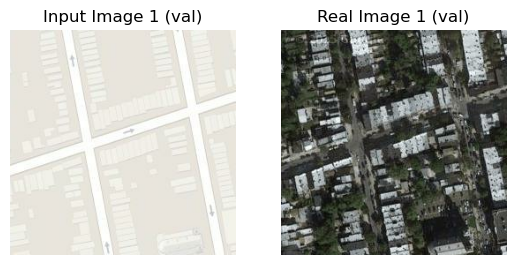

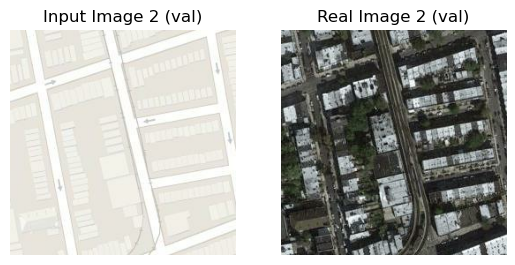

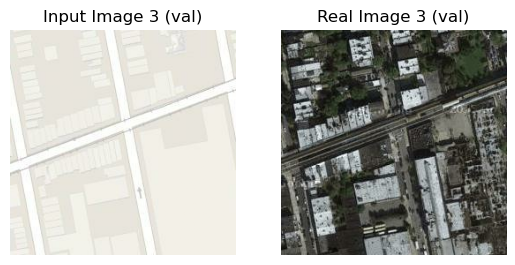

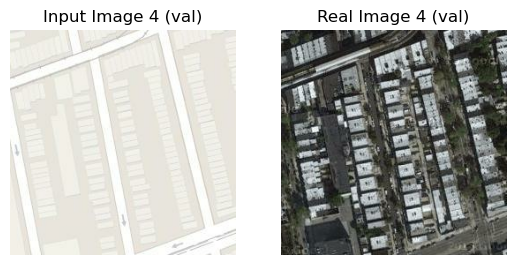

In [7]:
val_inputs, val_reals = next(iter(val_patches_b10.take(1)))

for i, (val_input, val_real) in enumerate(zip(val_inputs, val_reals)):
    if i == 4:
        break
    pxu.show(val_input, val_real, i + 1, "val")

### Dataset with original images

In [8]:
val_resized = tf.data.Dataset.list_files(val_path)

In [9]:
val_resized = val_resized.map(pxu.load_image)
val_resized = val_resized.map(lambda input_image, real_image: pxu.resize_images(input_image, real_image, image_size))
val_resized = val_resized.map(pxu.rescale_images)

val_resized_b1 = val_resized.batch(1)
val_resized_b4 = val_resized.batch(4, drop_remainder=True)
val_resized_b10 = val_resized.batch(10, drop_remainder=True)

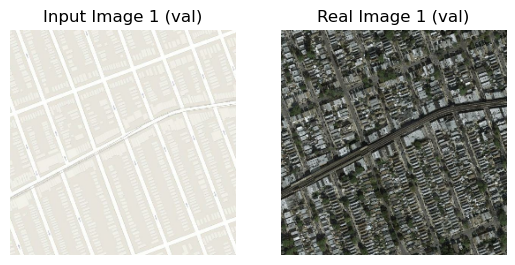

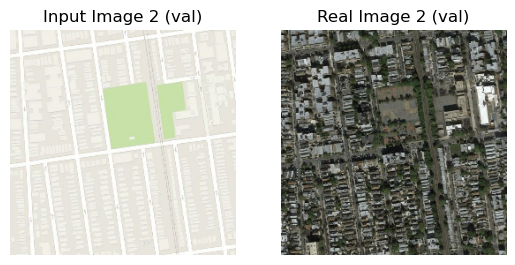

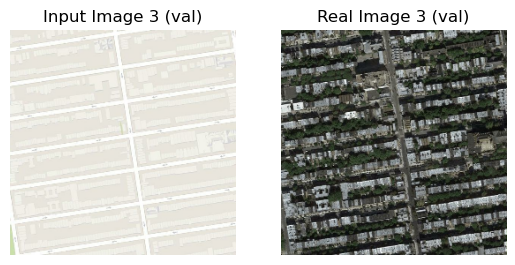

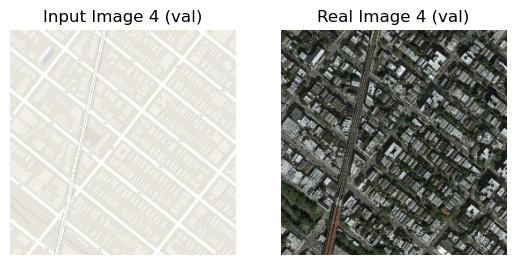

In [10]:
val_inputs, val_reals = next(iter(val_resized_b10.take(1)))

for i, (val_input, val_real) in enumerate(zip(val_inputs, val_reals)):
    if i == 4:
        break
    pxu.show(val_input, val_real, i + 1, "val")

## Load generators from Weights & Biases

In [11]:
def restore_generator(path: str, epoch: int) -> tf.keras.Model:
    model_file = wandb.restore(f"checkpoints/generator_{epoch}.h5", run_path=path)
    return load_model(model_file.name)

In [12]:
# trained for 400 epochs, batch size 1, rf 70, resized only
b1_e400_rf70_resized = restore_generator("nsiete23/pix2pix/ll4nj3s5", 200)

# trained for 200 epochs, batch size 1, rf 70, extracted patches
b1_e200_rf70_patches = restore_generator("nsiete23/pix2pix/411tf3wg", 60)

# trained for 200 epochs, batch size 1, rf 286, extracted patches
b1_e200_rf286_patches = restore_generator("nsiete23/pix2pix/mnzvt8nr", 140)

# these next 2 models had incorrect receptive field sizes (not 70 but 94)

# trained for 200 epochs, batch size 4, rf 70, extracted patches
b4_e200_rf70_patches = restore_generator("nsiete23/pix2pix/nchuafyo", 200)

# trained for 150 epochs, batch size 10, rf 70, extracted patches
b10_e150_rf70_patches = restore_generator("nsiete23/pix2pix/stcvub7p", 150)

## Evaluate models

In [13]:
n_samples = 8

### Dataset with extracted patches

Evaluation started...
Means over step 4392 - SSIM: 0.0660, PSNR: 12.9708, L1: 0.3462, HP-L1: 0.1568


               Evaluation Results                
┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃ Metric ┃ Mean    ┃ Min     ┃ Max     ┃ Std    ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ SSIM   │ 0.1576  │ -0.0621 │ 0.9641  │ 0.1427 │
│ PSNR   │ 14.1460 │ 8.6875  │ 33.6759 │ 2.9903 │
│ L1     │ 0.3114  │ 0.0299  │ 0.6231  │ 0.0805 │
│ HP-L1  │ 0.1108  │ 0.0111  │ 0.1648  │ 0.0261 │
└────────┴─────────┴─────────┴─────────┴────────┘

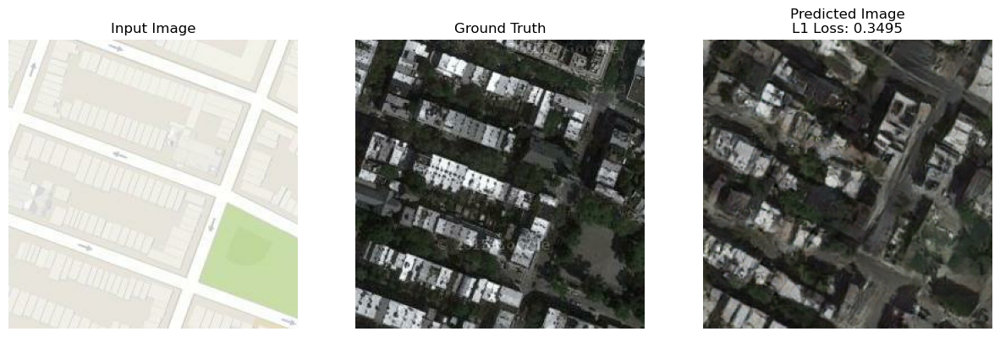

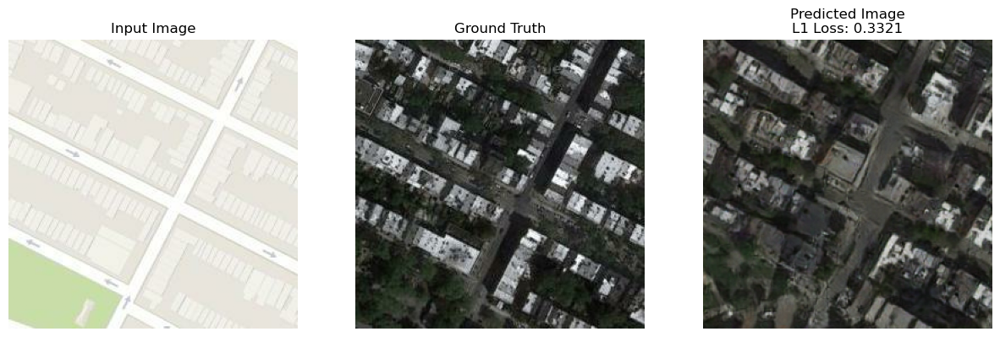

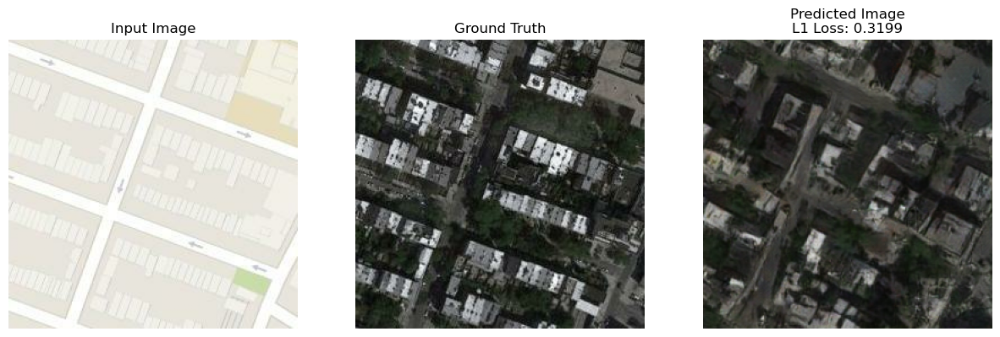

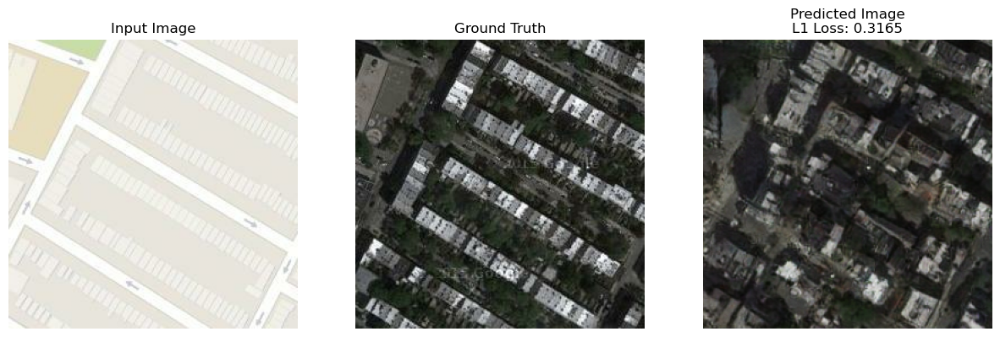

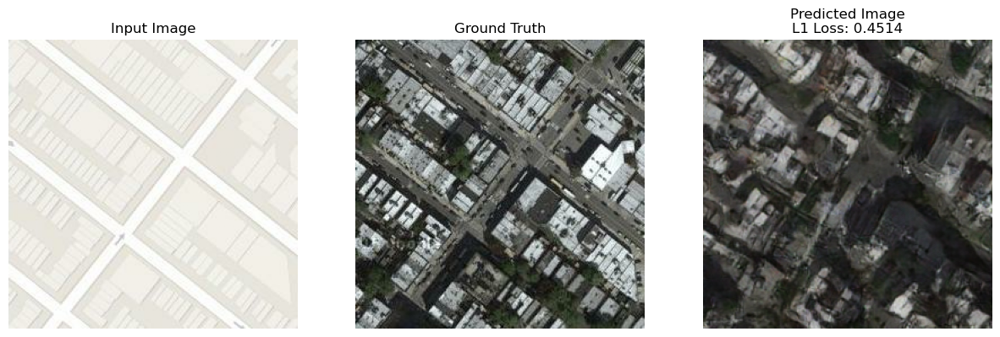

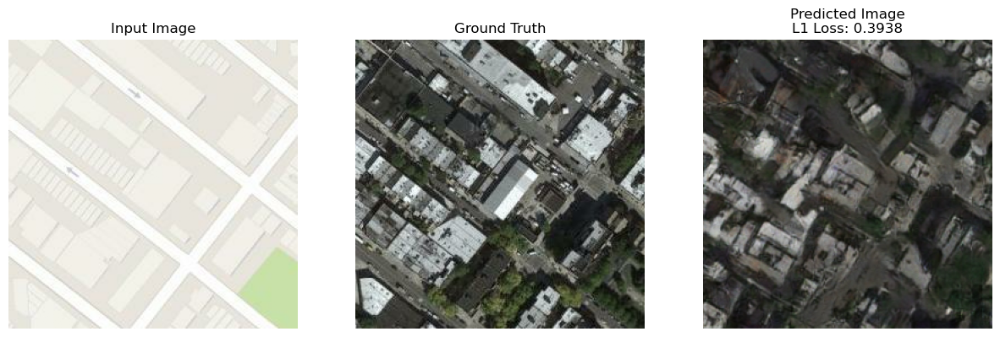

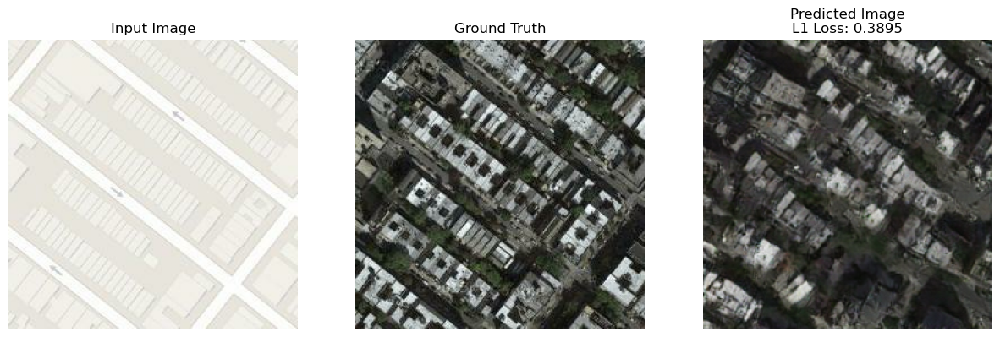

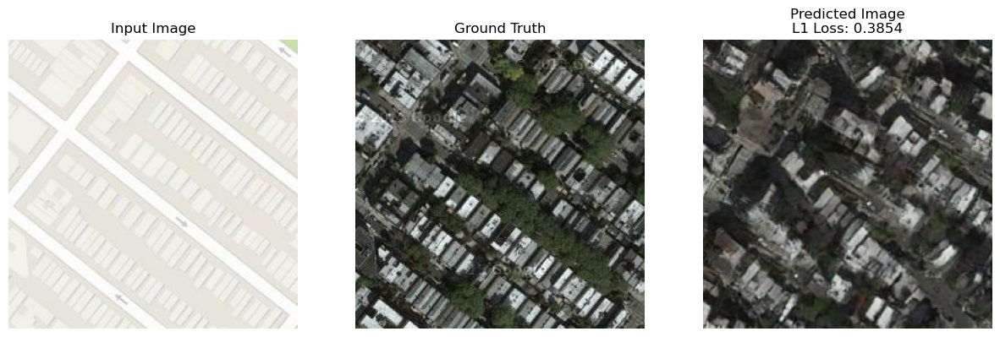

In [19]:
_ = evaluate(b1_e200_rf70_patches, val_patches_b1, n_samples=n_samples)

Evaluation started...
Means over step 4392 - SSIM: 0.1862, PSNR: 13.8351, L1: 0.2983, HP-L1: 0.0909


               Evaluation Results                
┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃ Metric ┃ Mean    ┃ Min     ┃ Max     ┃ Std    ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ SSIM   │ 0.1656  │ -0.0550 │ 0.9602  │ 0.1356 │
│ PSNR   │ 14.5018 │ 8.0866  │ 34.5621 │ 2.7823 │
│ L1     │ 0.2977  │ 0.0290  │ 0.7322  │ 0.0722 │
│ HP-L1  │ 0.1136  │ 0.0134  │ 0.1728  │ 0.0254 │
└────────┴─────────┴─────────┴─────────┴────────┘

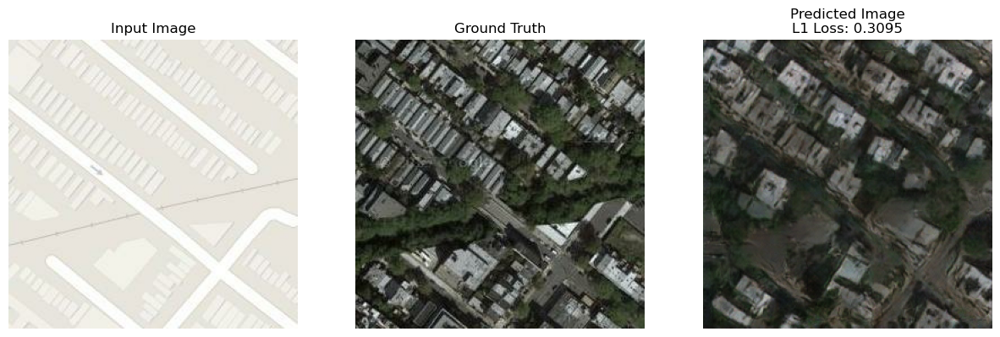

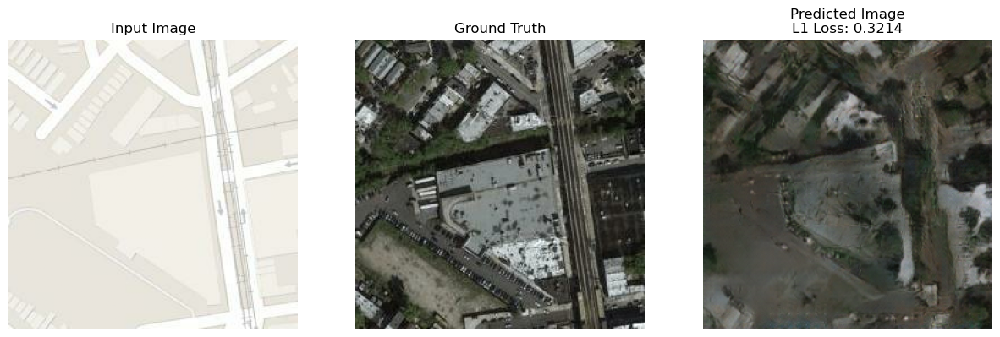

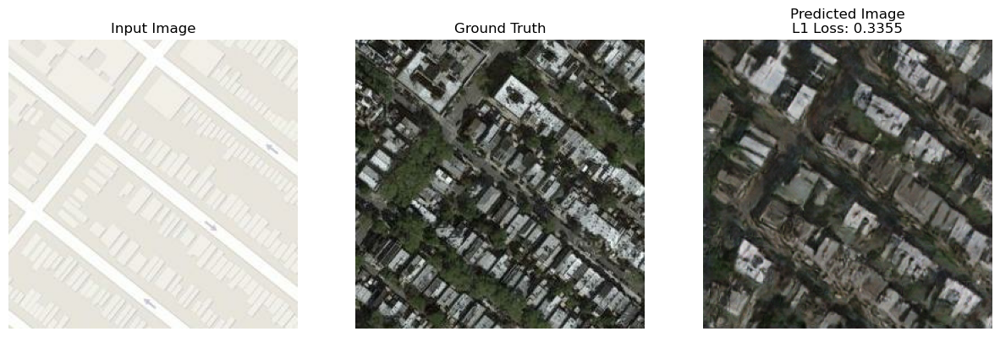

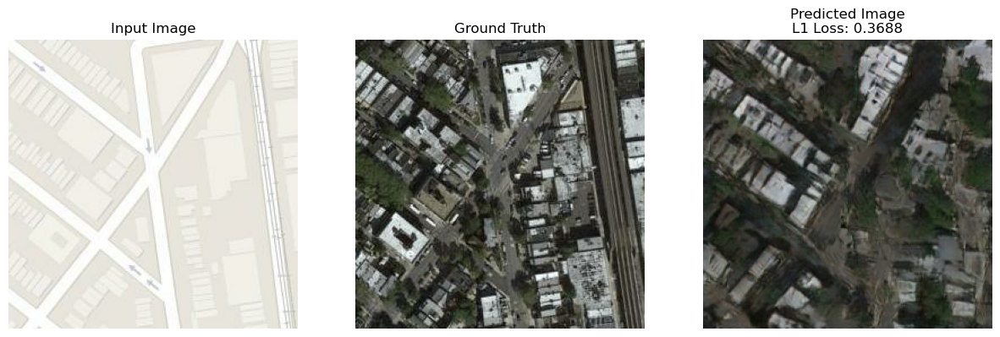

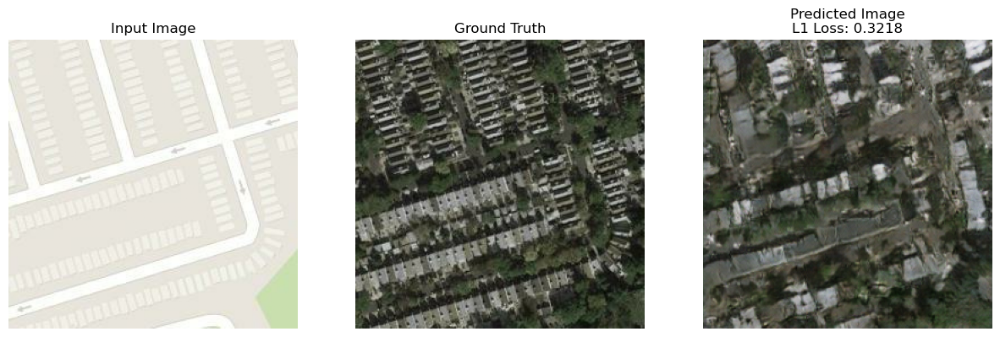

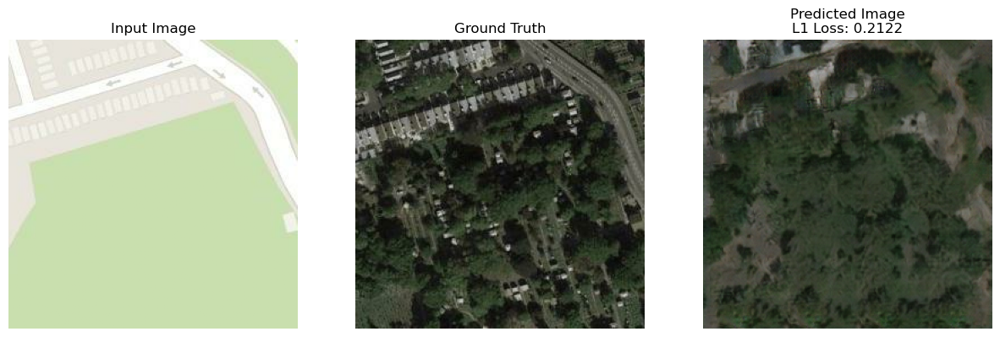

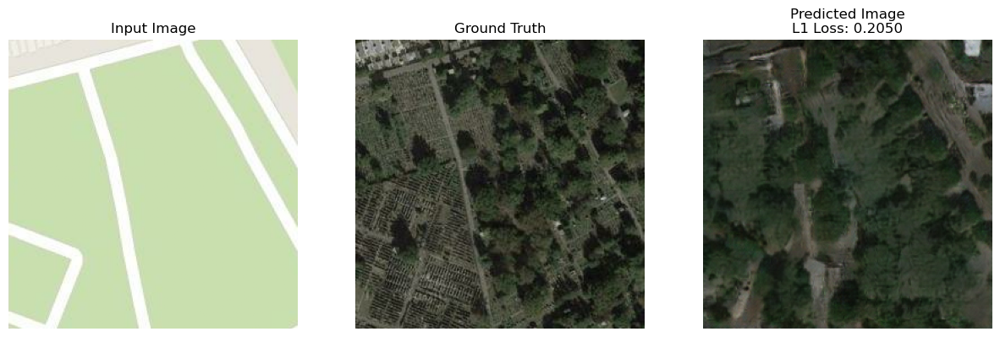

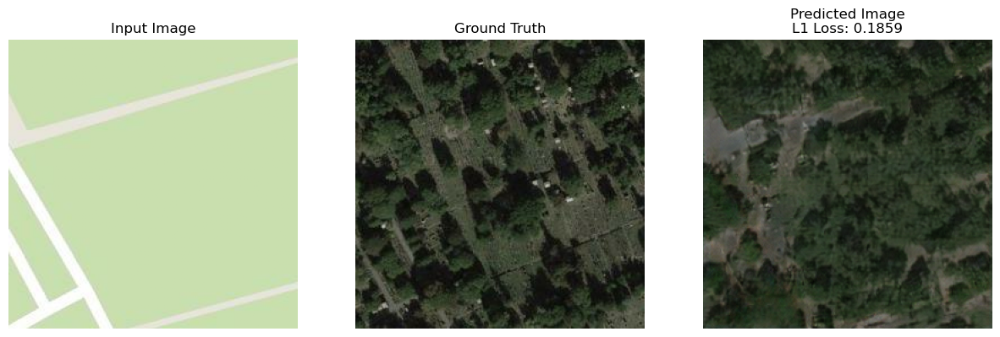

In [15]:
_ = evaluate(b1_e200_rf286_patches, val_patches_b1, n_samples=n_samples)

Evaluation started...
Means over step 1098 - SSIM: 0.1334, PSNR: 14.0363, L1: 0.2985, HP-L1: 0.1017


               Evaluation Results                
┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃ Metric ┃ Mean    ┃ Min     ┃ Max     ┃ Std    ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ SSIM   │ 0.1592  │ -0.0381 │ 0.9653  │ 0.1364 │
│ PSNR   │ 14.6817 │ 8.7748  │ 33.6167 │ 2.8260 │
│ L1     │ 0.2913  │ 0.0332  │ 0.6202  │ 0.0720 │
│ HP-L1  │ 0.0969  │ 0.0089  │ 0.1416  │ 0.0225 │
└────────┴─────────┴─────────┴─────────┴────────┘

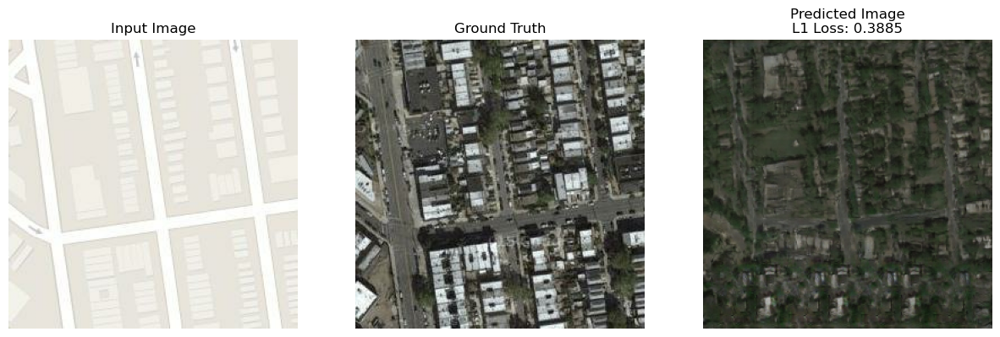

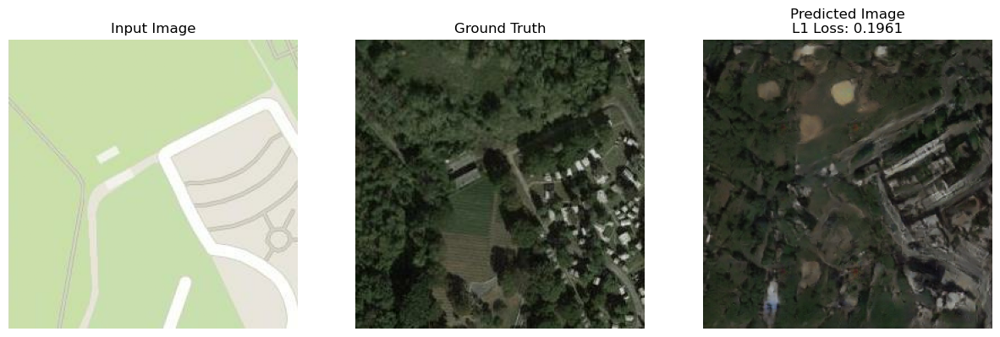

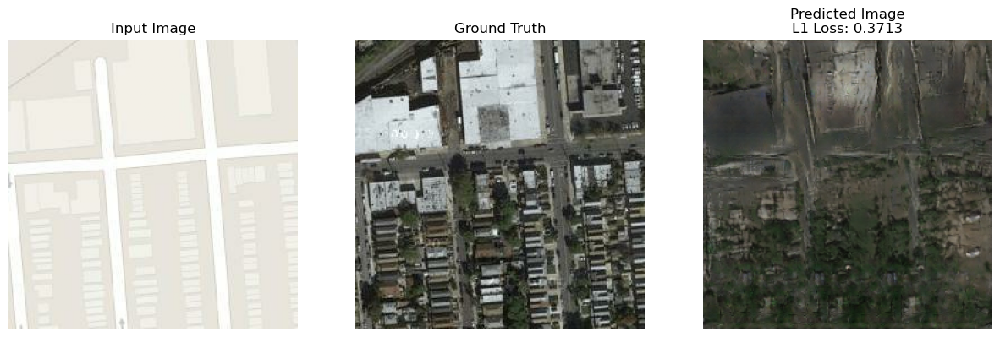

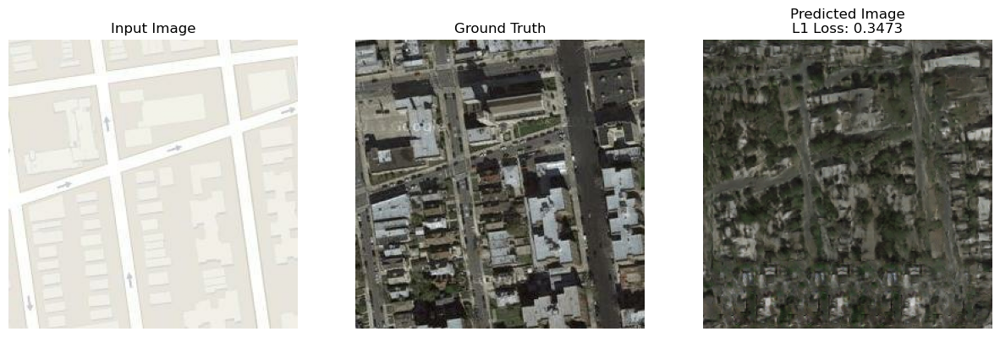

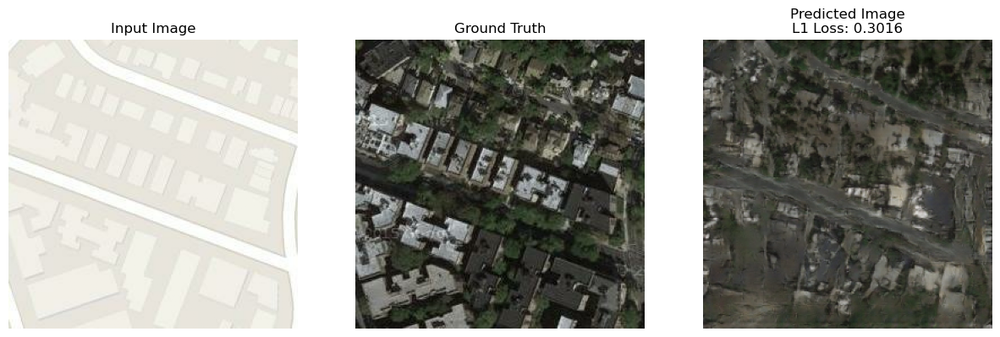

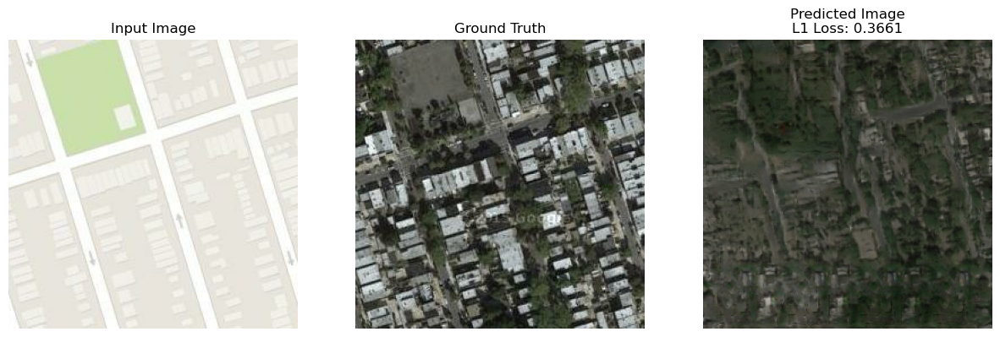

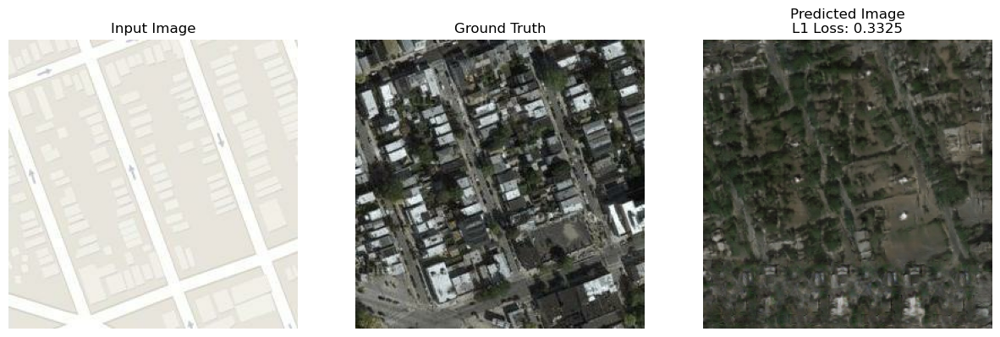

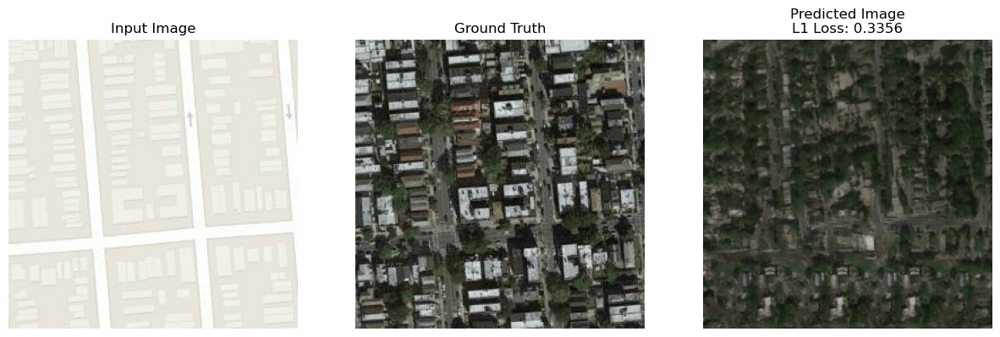

In [16]:
_ = evaluate(b4_e200_rf70_patches, val_patches_b4, n_samples=n_samples)

Evaluation started...
Means over step 439 - SSIM: 0.1259, PSNR: 13.7617, L1: 0.3347, HP-L1: 0.0986


               Evaluation Results                
┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃ Metric ┃ Mean    ┃ Min     ┃ Max     ┃ Std    ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ SSIM   │ 0.1549  │ -0.0336 │ 0.8826  │ 0.1278 │
│ PSNR   │ 14.1051 │ 7.8994  │ 32.6551 │ 2.8017 │
│ L1     │ 0.3123  │ 0.0345  │ 0.7272  │ 0.0766 │
│ HP-L1  │ 0.0932  │ 0.0138  │ 0.1580  │ 0.0266 │
└────────┴─────────┴─────────┴─────────┴────────┘

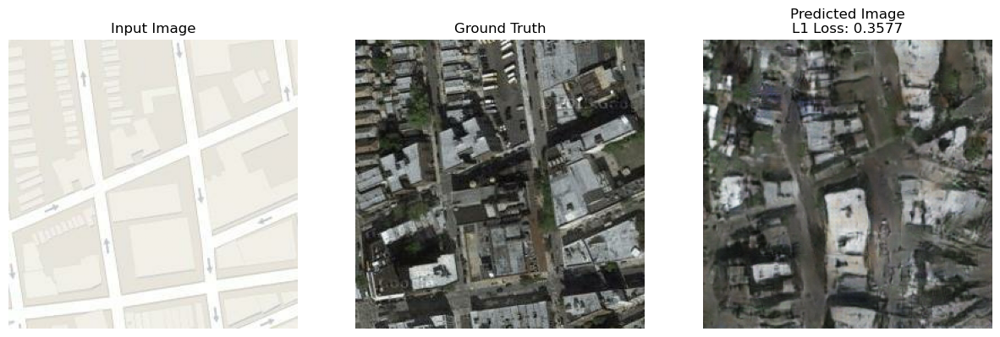

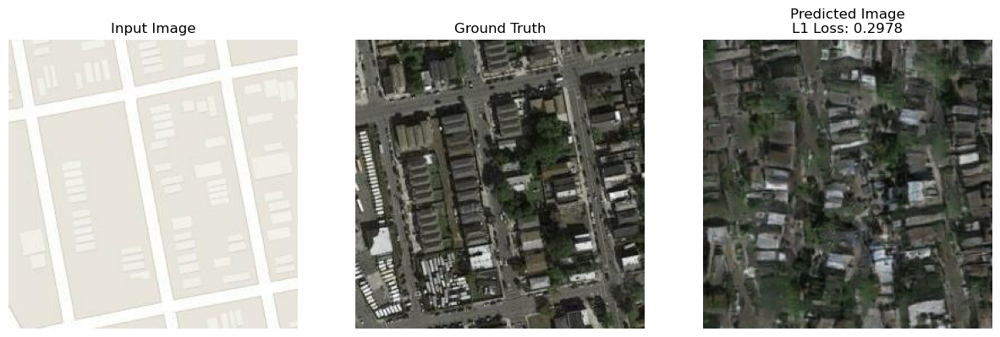

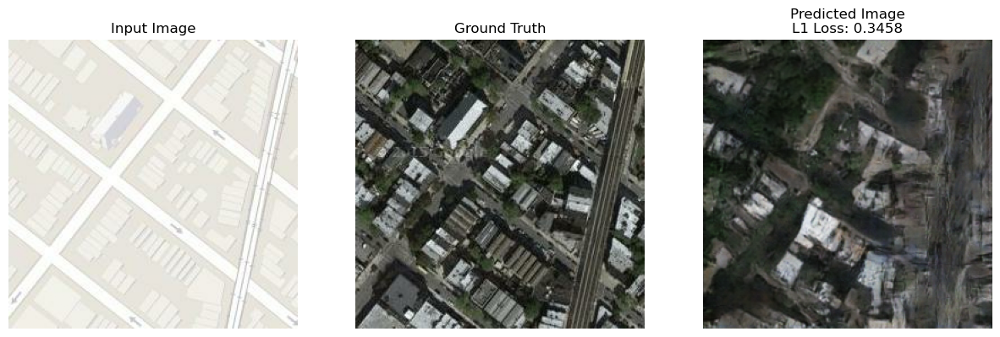

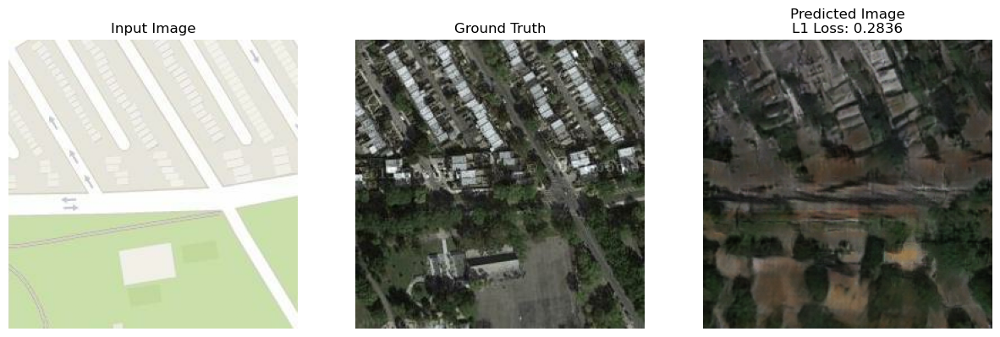

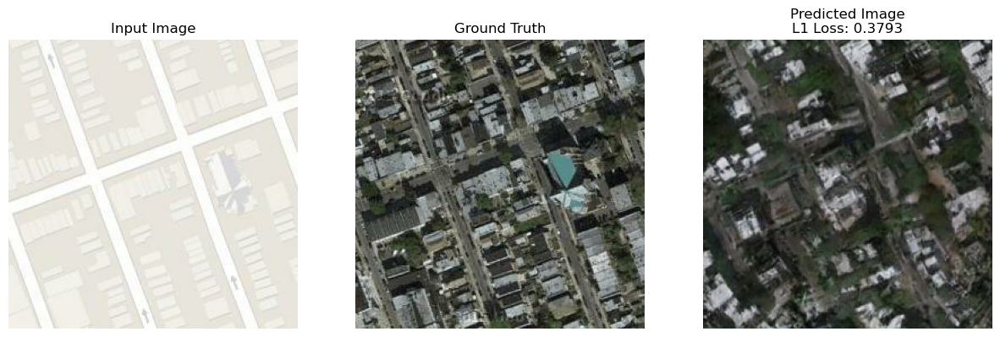

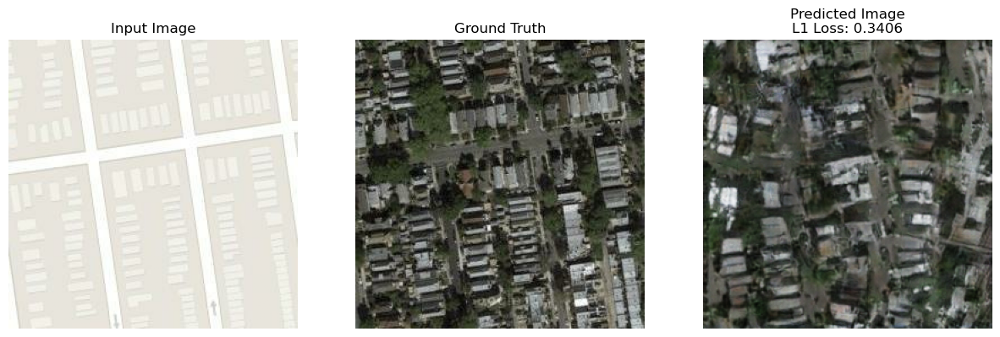

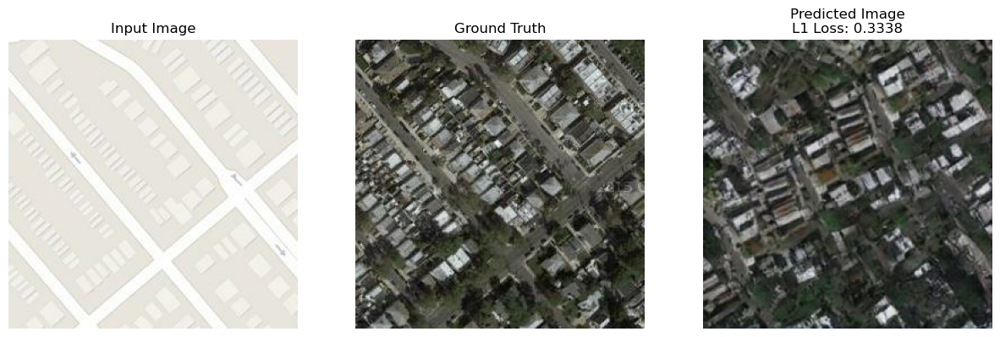

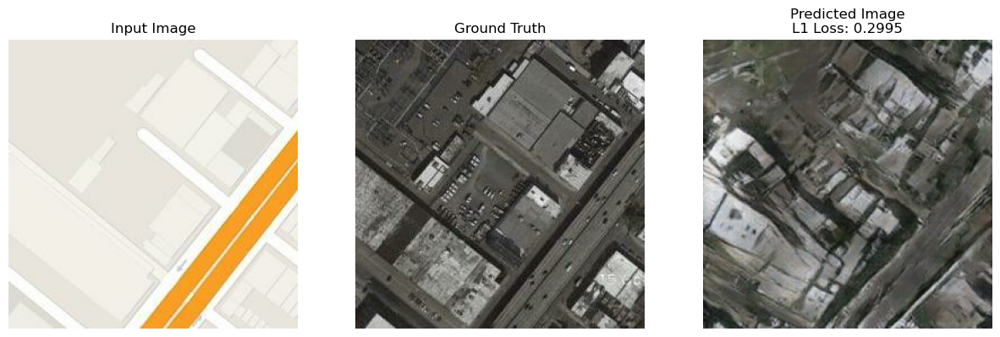

In [17]:
_ = evaluate(b10_e150_rf70_patches, val_patches_b10, n_samples=n_samples)

### Dataset with resized images

Evaluation started...
Means over step 1098 - SSIM: 0.1139, PSNR: 14.5496, L1: 0.2722, HP-L1: 0.1131


               Evaluation Results                
┏━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃ Metric ┃ Mean    ┃ Min     ┃ Max     ┃ Std    ┃
┡━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ SSIM   │ 0.1117  │ 0.0256  │ 0.8711  │ 0.1124 │
│ PSNR   │ 14.2976 │ 10.7300 │ 27.7124 │ 2.1979 │
│ L1     │ 0.2992  │ 0.0716  │ 0.4493  │ 0.0630 │
│ HP-L1  │ 0.1258  │ 0.0308  │ 0.1767  │ 0.0247 │
└────────┴─────────┴─────────┴─────────┴────────┘

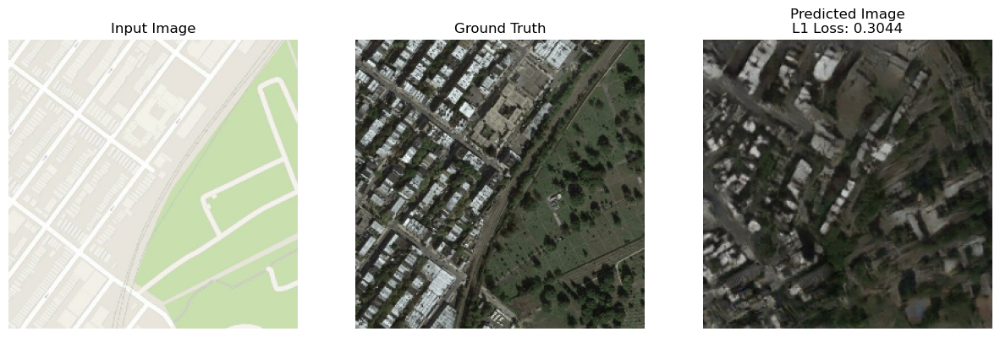

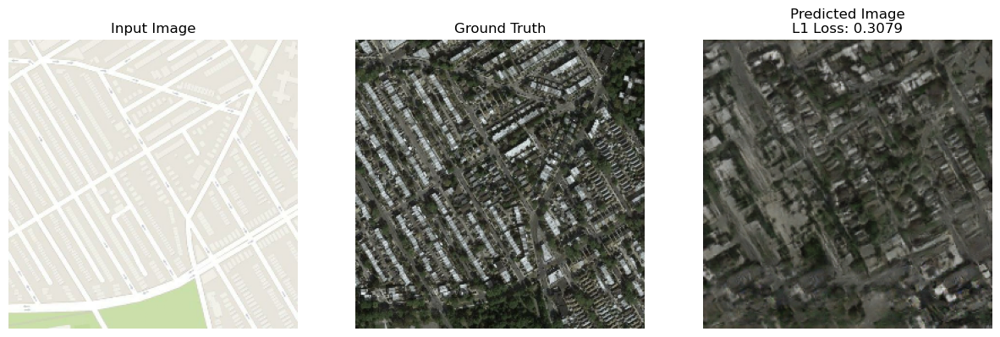

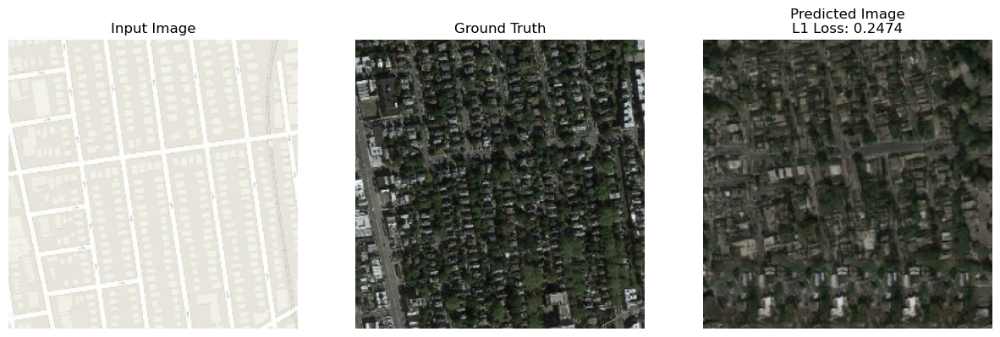

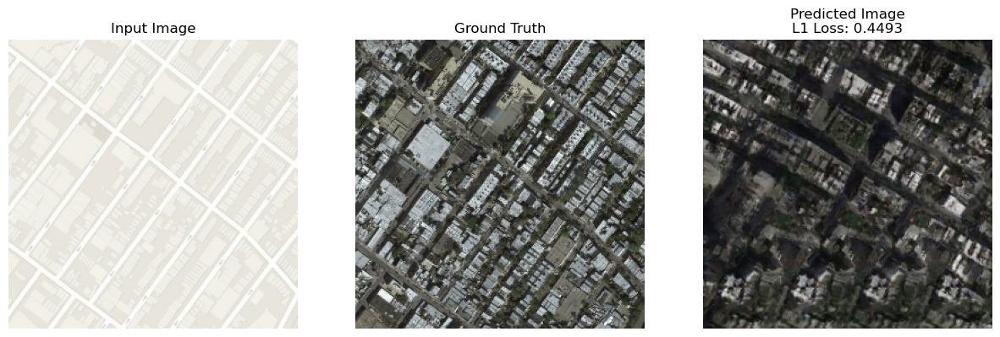

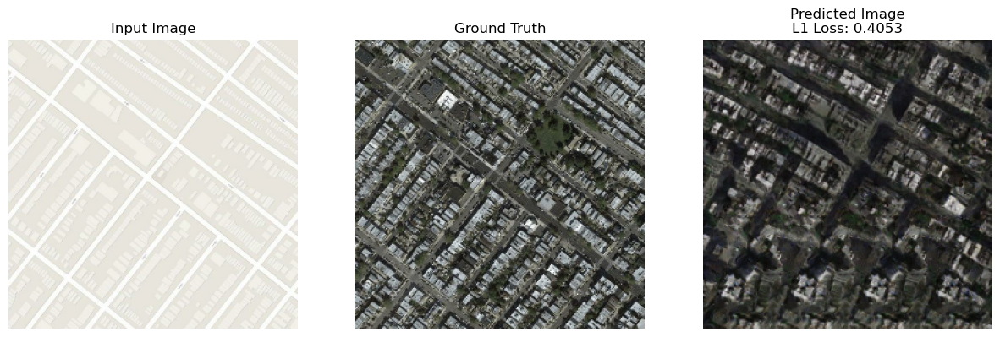

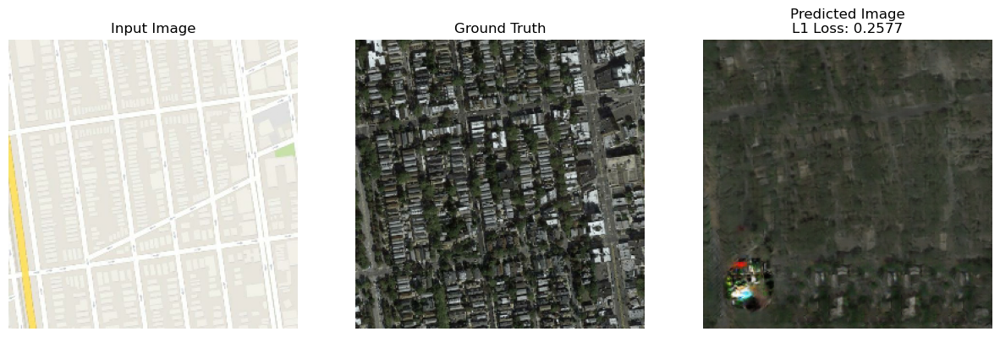

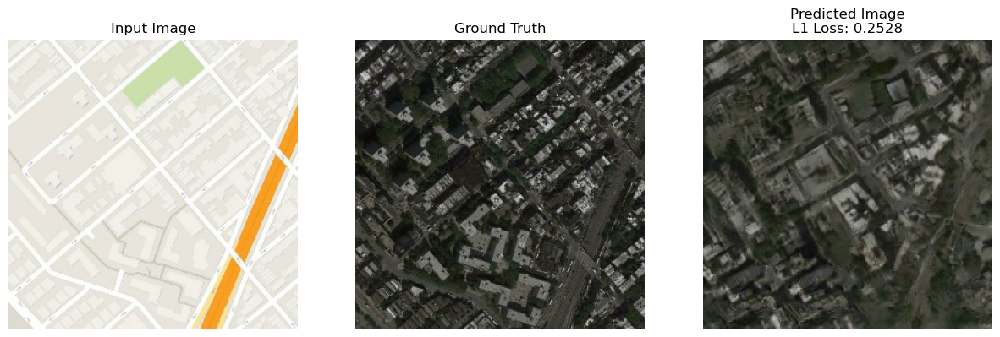

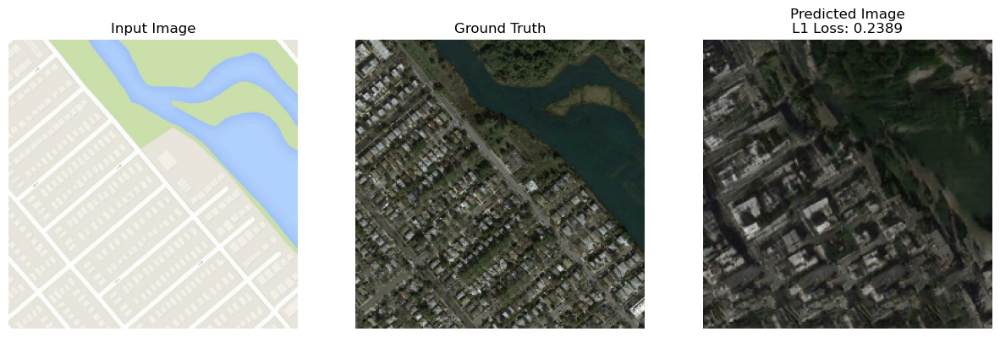

In [18]:
_ = evaluate(b1_e400_rf70_resized, val_resized_b1, n_samples=n_samples)